In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import cv2
from dask.distributed import Client, LocalCluster
from dask import delayed, compute
from dask import bag, array as da
%load_ext autoreload
%autoreload 2
%pylab inline

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Populating the interactive namespace from numpy and matplotlib


In [4]:
#from multiprocessing import Pool
#pool = Pool(30)

In [5]:
#cluster = LocalCluster(n_workers=30, threads_per_worker=1)

In [6]:
#client = Client(scheduler_file='/home/bzr0014/schedfile')
#client = Client(cluster)
#client.restart()

In [7]:
pylab.rcParams['figure.figsize'] = (10, 9)
def threshold(img, low, high, label):
    w, h, d = img.shape
    masks = []
    for i in range(3):
        masks.append(img[:, :, i] <= high[i])
        masks.append(img[:, :, i] >= low[i])
    #masks.append(img[:, :, 2] > 200)
    mask = np.ones((w, h))
    for m in masks:
        mask *= m   
    return(mask * label)
def preprocess_label(label, shape):
    label = cv2.resize(label, shape)
    m1 = threshold(label, [0, 0, 0], [1, 1, 255], 1)
    m2 = threshold(label, [240, 0, 0], [255, 30, 255], 2)
    m3 = threshold(label, [255, 255, 255], [255, 255, 255], 3)
    #m4 = threshold(label, [0, 0, 240], [60, 255, 255], 4)
    m = m1 + m2 + m3 #+ m4
    m = cv2.erode(m, np.ones((3, 3)))
    return m

In [8]:
import joblib

In [9]:
B = {0, 5, 10, 15, 19, 20, 26, 29, 35, 37, 43, 45, 51, 55, 57, 60, 69, 73, 76, 82, 86, 90, 93, 99, 102,
 104, 107, 111, 113, 118, 121, 125, 128, 138, 141, 144, 151, 154, 156, 160, 164, 169, 178, 186, 188,
 192, 201, 206, 210, 214, 219, 221, 226, 230, 234, 237, 243, 249, 255, 257, 261, 267, 271, 272, 277, 280,
 285, 291, 295, 296, 310, 313, 319, 323, 325, 330, 332, 338, 343, 347, 349, 355, 358, 362, 366, 371, 374,
 376, 381, 386, 388, 393, 399, 405, 411, 413, 418, 420, 424, 431, 435, 439, 446, 448, 465, 467, 468, 472,
 476, 482, 484, 624, 633, 636, 640, 645, 650, 659, 663, 664, 669, 672, 678, 680, 684, 689, 693, 696, 702, 706,
 710, 712, 721, 724, 728, 731, 733, 739, 740, 747, 751, 752, 757, 762, 764, 769, 784, 791, 792, 794, 799, 811,
 813, 817, 826, 830}
miss_center = set(range(456, 624))
bad = {64, 68, 123, 139, 172, 175, 181, 217, 287, 340, 422, 428, 444, 447, 454, 460, 463, 464, 
       470, 473, 475, 486, 487, 488, 498, 630, 637, 694, 771, 804, 861}

In [10]:
A = set(range(832)) - (B | bad | miss_center)

In [11]:
_masked_images   = (joblib.load('cleaned_muscles.pkl'))
_raw_images = (joblib.load('raw_images.pkl'))
_original_images = (joblib.load('images.pkl'))
_masked_images   = [_masked_images[i] for i in A]
_raw_images = [_raw_images[i] for i in A]
_original_images = [_original_images[i] for i in A]
#masked_images   = bag.from_sequence(_masked_images)
#raw_images   = bag.from_sequence(_raw_images)
#original_images = bag.from_sequence(_original_images)
#del _masked_images  
#del _raw_images
#del _original_images

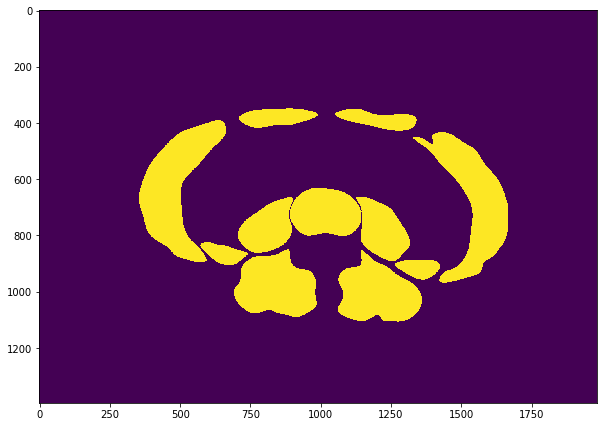

In [12]:
plt.imshow(_masked_images[0])

In [54]:
import scipy.stats as st
from scipy.ndimage.filters import convolve

def gkern2d(kernlen=21, nsig=3):
    """
    @param: kernlen: size of the 2d kernel
    @nsig: sigma for the 2d gaussian distribution
    returns: a gaussian kernel scaled so that the middle point set to 1
    """
    """Returns a 2D Gaussian kernel."""
    x = np.linspace(-nsig, nsig, kernlen+1)
    kern1d = np.diff(st.norm.cdf(x))
    kern2d = np.outer(kern1d, kern1d)
    return kern2d/kern2d.max()
def get_fucked(x, y):
    x = np.mean(x, axis=2)
    _1, cnts, _2 = cv2.findContours(y.copy(),cv2.RETR_CCOMP,cv2.CHAIN_APPROX_SIMPLE)
    imt = np.zeros_like(y)
    cv2.drawContours(imt, cnts, -1, 255, 10)
    assert x.shape[:2] == y.shape[:2]
    X = []
    for cnt in cnts:
        cnt = cnt.reshape(-1, 2)
        X.append(np.array([cnt.min(axis=0), cnt.max(axis=0), cnt.mean(axis=0)]))
    _ = np.array(X).reshape(-1, 6)
    return np.concatenate([_, np.argsort(_, axis=0)], axis=1)
    #plt.imshow(get_torso_outline((x, y)))

n = 10
_ = get_fucked(_original_images[n], _masked_images[n]-1)

In [29]:
def filter_contour(img=None):
    def _filter_contour(x):
        _, rct_w, _, rct_h = cv2.boundingRect(x)
        cnt_area = cv2.contourArea(x)
        area_cnd = True
        if img is not None:
            area_cnd = (cnt_area / len(img.reshape(-1))) > .3
        return (rct_h / (rct_w+1e-8) < 10)  & area_cnd
    return _filter_contour
def get_torso(img, block_sizes):
    if len(img.shape) > 2:
        grey_img = img.mean(axis=2).astype('uint8')
    else:
        grey_img = img.astype('uint8')
    for block_size in block_sizes:
        thrshldd_img = cv2.adaptiveThreshold(grey_img, 1, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, block_size, 0)
        #thrshldd_img = cv2.adaptiveThreshold(grey_img, 1, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, block_size, 0)
        erdd_img = cv2.erode(thrshldd_img, np.ones((5,5)))
        _, cnts, _ = cv2.findContours(erdd_img.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
        cnts = sorted(filter(filter_contour(thrshldd_img), cnts), key=lambda x: -len(x))
        if len(cnts):
            break
    return cnts, thrshldd_img

In [30]:
def get_torso_outline(x):
    orig, masked = x
    print(tuple(i.shape for i in x))
    cnts, thrshldd_img = get_torso(orig, 
                               #range(501, 50, -10)
                               range(501, 50, -10)
                              )
    if len(cnts) == 0:
        return
    img_to_drw = np.zeros_like(thrshldd_img)
    _ = cv2.drawContours(img_to_drw, cnts[:1], -1, 1, 40)
    scnd_img_to_drw = np.zeros_like(thrshldd_img)
    _, cnts, _ = cv2.findContours(img_to_drw.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(cnts, key = lambda x: -len(x))
    _ = cv2.drawContours(scnd_img_to_drw, cnts, 0, 1, -11)
    kernel = np.ones((10, 10))
    out_and_masked = scnd_img_to_drw*thrshldd_img
    rszd_out_and_masked = cv2.resize(out_and_masked, masked.shape[::-1])
    out = cv2.dilate(masked | rszd_out_and_masked, kernel)
    return out

((1400, 1400, 3), (1400, 1400))


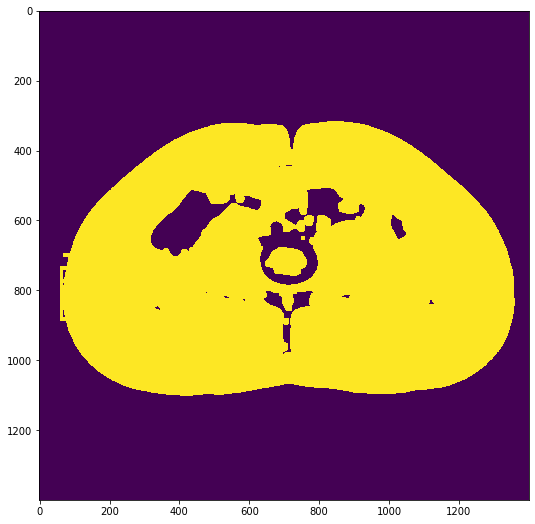

In [12]:
img_indx = np.random.randint(len(_raw_images))
scnd_img_to_drw = get_torso_outline((_original_images[img_indx], _masked_images[img_indx]-1))
if scnd_img_to_drw is None:
    print("is None")
else:
    plt.imshow(scnd_img_to_drw)

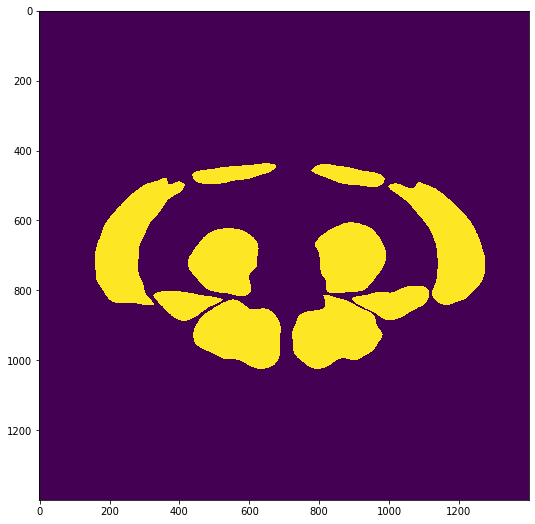

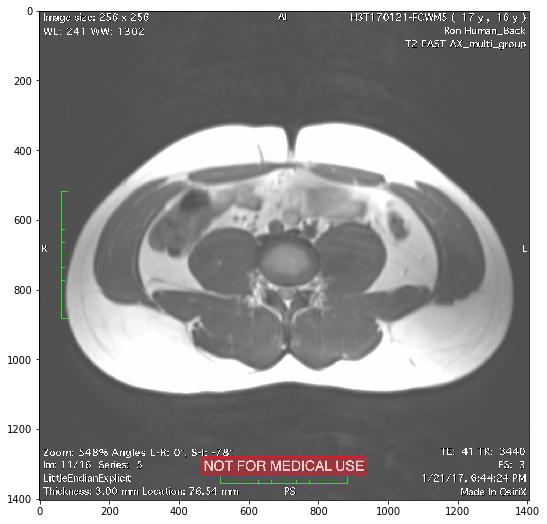

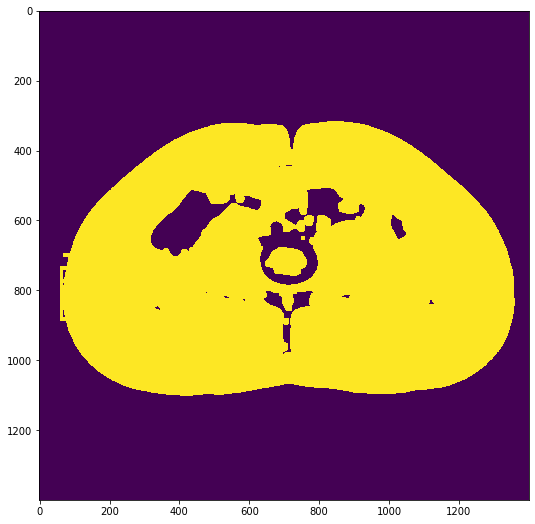

In [13]:
plt.imshow(_masked_images[img_indx])
plt.show()
plt.imshow(_raw_images[img_indx])
plt.show()
plt.imshow(scnd_img_to_drw)

In [14]:
def resize_image(x, width):
    w, h, *_ = x.shape
    new_shape = h*width//w, width
    return cv2.resize(x, new_shape)

def resize_images(args, dsize):
    return tuple(cv2.resize(x, dsize) for x in args)

def resize_image(args, dsize):
    return cv2.resize(args, dsize)


# 1. Setting mask margins to a certain value so they are never picked for training or test
def mark_margins(y, n_size):
    x = y.copy()
    m = n_size//2+1
    x[:m] = 255
    x[-m:] = 255
    x[:, :m] = 255
    x[:, -m:] = 255
    return x

# zooming in as much as possigle on the area of interes
# which is teh traced muscles
def crop_image(args, neigh_size):
    m = neigh_size//2
    x, y = args
    pts = np.where(y==1)
    w, h = y.shape
    x_mn = max(0, np.min(pts[0])-m)
    x_mx = min(w, np.max(pts[0])+m)
    y_mn = max(0, np.min(pts[1])-m)
    y_mx = min(h, np.max(pts[1])+m)
    #r = int((y_mx - y_mn)/(x_mx-x_mn) * resize)
    return x[x_mn:x_mx, y_mn:y_mx], y[x_mn:x_mx, y_mn:y_mx]

def normalize_image(img):
    img = img.astype('uint8')
    hist,bins = np.histogram(img.flatten(),256,[0,256])

    cdf = hist.cumsum()
    cdf_m = np.ma.masked_equal(cdf,0)
    cdf_m = (cdf_m - cdf_m.min())*255/(cdf_m.max()-cdf_m.min())
    cdf = np.ma.filled(cdf_m,0).astype('uint8')
    return cdf[img]
def get_shape_ratios(args):
    x, y = args
    r1 = x.shape[1]/x.shape[0]
    r2 = y.shape[1]/y.shape[0]
    return np.abs(r1-r2) < .01

In [15]:
def get_neighbors(xy, neigh_size, step):
    m = neigh_size//2
    if isinstance(xy, tuple):
        x, y = xy
        # change later
        x = (x-x.mean())/x.std()
        w, h, *_ = x.shape
        X = []
        Y = []
        for i in range(m, w-m, step):
            for j in range(m, h-m, step):
                X.append(x[i-m:i+m, j-m:j+m])
                Y.append(y[i, j])
        return np.array(X), np.array(Y)
    else:
        x = xy
        x = (x-x.mean())/x.std()
        w, h, *_ = x.shape
        X = []
        for i in range(m, w-m, step):
            for j in range(m, h-m, step):
                X.append(x[i-m:i+m, j-m:j+m])
        return np.array(X)
    
def get_neighbors_masked(xyz, neigh_size, step):
    m = neigh_size//2
    if isinstance(xyz, tuple):
        x, y, z= xyz
        # change later
        x = (x-x.mean())/x.std()
        w, h, *_ = x.shape
        X = []
        Y = []
        for i, j in zip(*np.where(z)):
            X.append(x[i-m:i+m, j-m:j+m])
            Y.append(y[i, j])
        return np.array(X), np.array(Y)
    else:
        x = xyz
        x = (x-x.mean())/x.std()
        w, h, *_ = x.shape
        X = []
        for i, j in zip(*np.where(z)):
            X.append(x[i-m:i+m, j-m:j+m])
        return np.array(X)

In [16]:
#PARAMS
dsize = resize_width, resize_height = 300, 300
neighSize = 41
STEP = 2

In [17]:
#x = raw_images.map(lambda x: x.mean(axis=2))
#y = masked_images.map(lambda x: x-1)#.map(mark_margins, n_size=neighSize)
##z = bag.zip(x, y).map(get_torso_outline)#.map(mark_margins, n_size=neighSize)

In [18]:
#xy  = bag.zip(x, y).filter(get_shape_ratios)
#z   = xy.map(get_torso_outline)

In [19]:
#rszd_x = x.map(resize_image, dsize=dsize)

In [20]:
#rszd_y = y.map(resize_image, dsize=dsize)
#rszd_z = z.map(resize_image, dsize=dsize)
#nrmlzd_rszd_x = rszd_x.map(normalize_image)
#xyz = bag.zip(nrmlzd_rszd_x, rszd_y, z).map(get_neighbors_masked, neigh_size=neighSize, step=STEP)

In [21]:
#XYZ = xyz.compute()

In [22]:
from multiprocessing import Pool
def gray_scale(x):
    if len(x.shape)>2:
        return x.mean(axis=2)
def min_1(x):
    return x-1   
with Pool(30) as p:
    x = p.map(gray_scale, _raw_images)
    y = p.map(min_1, _masked_images)#.map(mark_margins, n_size=neighSize)

In [23]:
with Pool(30) as p:
    cond = p.map(get_shape_ratios, zip(x, y))

In [24]:
x = [i for i, c in zip(x, cond) if c]
y = [i for i, c in zip(y, cond) if c]

In [28]:
from pathos.multiprocessing import ProcessingPool, ThreadingPool
z = map(get_torso_outline, zip(x, y))

In [29]:
z = list(z)

((1404, 1996), (1396, 1985))
((1404, 1996), (1396, 1985))
((1404, 1996), (1396, 1985))
((1393, 1981), (1396, 1985))
((1393, 1981), (1396, 1985))
((1393, 1981), (1396, 1985))
((1404, 1996), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1393, 1981), (1396, 1985))
((1393, 1981), (1396, 1985))
((1393, 1981), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1396, 1985))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1400, 1991))
((1400, 1991), (1390, 1976))
((1400, 1991), (1390, 1976))
((1400, 1991), (1394, 1982))
((1400, 1991),

((1404, 1404), (1400, 1400))
((1404, 1404), (1400, 1400))
((1400, 1400), (1400, 1400))
((1404, 1404), (1400, 1400))
((1404, 1404), (1400, 1400))
((1404, 1996), (1394, 1982))
((1404, 1996), (1394, 1982))
((1404, 1996), (1394, 1982))
((1393, 1981), (1394, 1982))
((1393, 1981), (1394, 1982))
((1393, 1981), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1404, 1996), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1393, 1981), (1394, 1982))
((1393, 1981), (1394, 1982))
((1393, 1981), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991), (1394, 1982))
((1400, 1991),

In [30]:
def mardas(i):
    return resize_image(i, dsize=dsize)

In [31]:
rszd_x = map(mardas, x)

In [32]:
rszd_x = list(rszd_x)

In [33]:
rszd_y = list(map(mardas, y))

In [34]:
rszd_z = list(map(lambda i: None if i is None else resize_image(i, dsize=dsize), z))

In [35]:
nrmlzd_rszd_x = list(map(normalize_image, rszd_x))

In [36]:
XYZ = list((x, y, z) for x, y, z in zip(nrmlzd_rszd_x, rszd_y, rszd_z) if z is not None)

In [37]:
joblib.dump(XYZ, 'XYZ.pkl')

['XYZ.pkl']

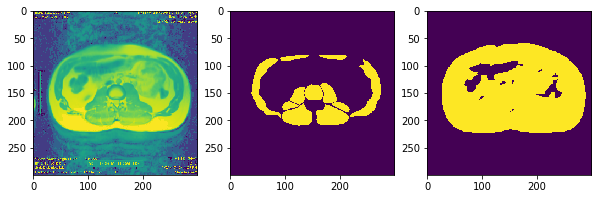

In [35]:
i = np.random.randint(len(XYZ))
fig, axes = plt.subplots(1, 3)
axes = axes.reshape(-1)
for i, x in enumerate(XYZ[i]):
    axes[i].imshow(x)

In [166]:
def get_neighbors_masked(xyz, neigh_size):
    m = neigh_size//2
    print(m)
    x, y, z= xyz
    # change later
    x = (x-x.mean())/x.std()
    w, h, *_ = x.shape
    X = []
    Y = []
    indices = list(zip(*np.where(z)))
    for i, j in indices:
        tmp = x[i-m:i+m, j-m:j+m]
        if tmp.shape == (2*m, 2*m):
            X.append(tmp)
            Y.append(y[i, j])
    return np.array(X), np.array(Y)

In [69]:
from pathos.multiprocessing import ProcessingPool, ThreadingPool
mardas = list(map(lambda x: get_neighbors_masked(x, neigh_size=neighSize), XYZ))

In [37]:
X = np.concatenate([x[0] for x in mardas])
Y = np.concatenate([x[1] for x in mardas])

TypeError: 'function' object is not iterable

In [72]:
#preload = xy_.compute()

# Preparing sampling
At this point, let's just take random samples, in the future I can change this so I can decide what proportion of each label I want to pick; that is, setting a weight for each label.

*It is important to note that in order to make random kernel truly random, we need to explicitly pass the random seed to them. Otherwise the random states for all kernels (i.e. get_sample below) will have the same random states, leading to the same results on different runs.*

In [73]:
Y.shape

(11507474,)

# Next Step
XY is saved in `./cleaned_data.pkl`.

In [74]:
#pip install joblib

In [75]:
#joblib.dump((X, Y), 'cleaned_data2.pkl')

In [76]:
import os
#os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"   # see issue #152
#os.environ["CUDA_VISIBLE_DEVICES"] = ""
import joblib
import numpy as np
import matplotlib.pyplot as plt
#X, Y = joblib.load('cleaned_data2.pkl')
#X = [x[0] for x in XY]
#Y = [x[1] for x in XY]

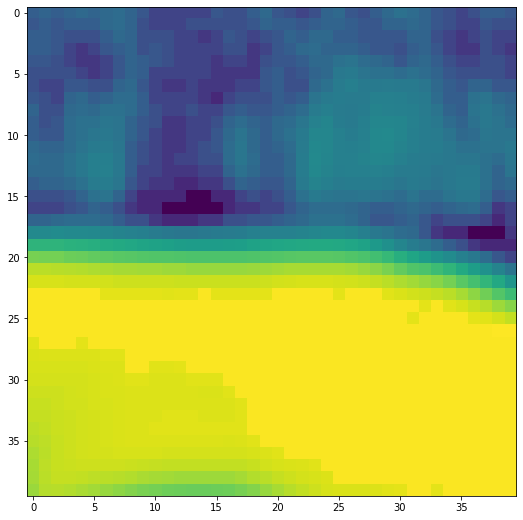

In [77]:
plt.imshow(X[156])

In [2]:
# keras important imports:
# import the necessary packages
from keras.models import Sequential
from keras.models import load_model
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.core import Activation
from keras.layers.core import Flatten
from keras.layers.core import Dropout
from keras.layers.core import Dense
from keras import backend as K

from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.regularizers import l2

Using TensorFlow backend.


# Model v02

In [51]:
# Keras simple deep model:
def build_v02(width, height, depth, reg, init="he_normal"):
    # initialize the model along with the input shape to be
    # "channels last" and the channels dimension itself
    model = Sequential()
    inputShape = (height, width, depth)
    chanDim = -1

    # if we are using "channels first", update the input shape
    # and channels dimension
    if K.image_data_format() == "channels_first":
        inputShape = (depth, height, width)
        chanDim = 1
        
    # our first CONV layer will learn a total of 16 filters, each
    # Of which are 7x7 -- we'll then apply 2x2 strides to reduce
    # the spatial dimensions of the volume
    #model.add(Conv2D(32, (10, 10), strides=(1, 1), padding="same",
    #    kernel_initializer=init,# kernel_regularizer=reg,
    #    input_shape=inputShape))

    # here we stack two CONV layers on top of each other where
    # each layerswill learn a total of 32 (3x3) filters
    model.add(Conv2D(32, (10, 10), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(32, (5, 5), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    model.add(Dropout(0.25))
    # stack two more CONV layers, keeping the size of each filter
    # as 3x3 but increasing to 64 total learned filters
    #model.add(Conv2D(64, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Conv2D(64, (3, 3), strides=(1, 1), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
#
    ## increase the number of filters again, this time to 128
    #model.add(Conv2D(128, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(10, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init,  #kernel_regularizer=reg
                    )
             )
    model.add(Activation("relu"))
    model.add(Conv2D(1, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    model.add(Activation("relu"))
    model.add(Flatten())
    model.add(Dense(100))
    model.add(Dense(10))
    model.add(Dense(1))
    model.add(Activation("sigmoid"))
    #model.add(BatchNormalization(axis=chanDim))
    return model

# Model v03

In [15]:
# Keras simple deep model:
def build_v03(width, height, depth, reg, init="he_normal"):
    # initialize the model along with the input shape to be
    # "channels last" and the channels dimension itself
    model = Sequential()
    inputShape = (height, width, depth)
    chanDim = -1

    # if we are using "channels first", update the input shape
    # and channels dimension
    if K.image_data_format() == "channels_first":
        inputShape = (depth, height, width)
        chanDim = 1
        
    # our first CONV layer will learn a total of 16 filters, each
    # Of which are 7x7 -- we'll then apply 2x2 strides to reduce
    # the spatial dimensions of the volume
    model.add(Conv2D(32, (30, 30), strides=(1, 1), padding="same",
        kernel_initializer=init,# kernel_regularizer=reg,
        input_shape=inputShape))
   
    model.add(Conv2D(32, (15, 15), strides=(1, 1), padding="same",
        kernel_initializer=init,# kernel_regularizer=reg,
        input_shape=inputShape))

    # here we stack two CONV layers on top of each other where
    # each layerswill learn a total of 32 (3x3) filters
    model.add(Conv2D(32, (10, 10), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    #model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(32, (5, 5), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    #model.add(Activation("relu"))
    #model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
    # stack two more CONV layers, keeping the size of each filter
    # as 3x3 but increasing to 64 total learned filters
    #model.add(Conv2D(64, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Conv2D(64, (3, 3), strides=(1, 1), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    #model.add(Dropout(0.25))
#
    ## increase the number of filters again, this time to 128
    #model.add(Conv2D(128, (3, 3), padding="same",
    #    kernel_initializer=init, kernel_regularizer=reg))
    #model.add(Activation("relu"))
    ##model.add(BatchNormalization(axis=chanDim))
    model.add(Conv2D(10, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init,  #kernel_regularizer=reg
                    )
             )
    model.add(Activation("relu"))
    model.add(Conv2D(1, (3, 3), strides=(1, 1), padding="same",
        kernel_initializer=init, #kernel_regularizer=reg)
                    ))
    #model.add(Activation("relu"))
    #model.add(Flatten())
    #model.add(Dense(100))
    #model.add(Dense(10))
    #model.add(Dense(1))
    model.add(Activation("sigmoid"))
    #model.add(BatchNormalization(axis=chanDim))
    return model

In [81]:
from sklearn.model_selection import train_test_split

In [82]:
X.shape

(11507474, 40, 40)

In [83]:
*_, m, n = X.shape
#if len(_) == 1:
#    X = X.reshape(-1, m, n, 1)
#    Y = Y.reshape(-1, 1)

In [84]:
Xtr, Xts, Ytr, Yts = train_test_split(X.reshape(*X.shape, 1), Y.reshape(*Y.shape, 1)==1, test_size=.2)

In [85]:
from sklearn.preprocessing import StandardScaler

In [50]:
from keras import losses
# creating and starting keras model example:
opt = Adam(lr=1e-4)#, decay=1e-4 / epochs)
#v02
#model = build(width=neighSize, height=neighSize, depth=1, reg=l2(0.0005))
model = build_v02(width=m, height=n, depth=1, reg=l2(0.0005))
model.compile(loss=losses.binary_crossentropy, optimizer=opt, metrics=["accuracy"])

NameError: name 'build_v02' is not defined

In [87]:
1 - (Ytr.sum()/(Ytr>-1).sum())

0.6613350953766025

In [88]:
Xtr.shape

(9205979, 40, 40, 1)

In [89]:
#model.fit(X, Y, batch_size=1)
# verion02
#model.fit_generator(gen(Xtr, Ytr, 10, neighSize), 1000, epochs=1000)#, validation_data=gen(Xts, Yts, 10, neighSize))
model.fit(Xtr, Ytr, batch_size=800, epochs=500)#, validation_data=gen(Xts, Yts, 10, neighSize))

Epoch 1/500
9205979/9205979 [==============================] - 3418s 371us/step - loss: 0.1841 - acc: 0.9273
Epoch 2/500
4750400/9205979 [==============>...............] - ETA: 27:30 - loss: 0.1428 - acc: 0.9442

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3416s 371us/step - loss: 0.1381 - acc: 0.9461
Epoch 3/500
 156000/9205979 [..............................] - ETA: 57:26 - loss: 0.1288 - acc: 0.9497

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



4910400/9205979 [===============>..............] - ETA: 26:36 - loss: 0.1263 - acc: 0.9507

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3416s 371us/step - loss: 0.1239 - acc: 0.9516
Epoch 4/500
3279200/9205979 [=========>....................] - ETA: 36:36 - loss: 0.1177 - acc: 0.9541

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3411s 371us/step - loss: 0.1156 - acc: 0.9548
Epoch 5/500
1606400/9205979 [====>.........................] - ETA: 46:56 - loss: 0.1116 - acc: 0.9564

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6348800/9205979 [===================>..........] - ETA: 17:38 - loss: 0.1105 - acc: 0.9567

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3408s 370us/step - loss: 0.1098 - acc: 0.9570
Epoch 6/500
1877600/9205979 [=====>........................] - ETA: 45:14 - loss: 0.1066 - acc: 0.9584

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6419200/9205979 [===================>..........] - ETA: 17:11 - loss: 0.1060 - acc: 0.9586

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3407s 370us/step - loss: 0.1056 - acc: 0.9587
Epoch 7/500
1952800/9205979 [=====>........................] - ETA: 44:45 - loss: 0.1032 - acc: 0.9595

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6703200/9205979 [====================>.........] - ETA: 15:26 - loss: 0.1027 - acc: 0.9598

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3406s 370us/step - loss: 0.1024 - acc: 0.9599
Epoch 8/500
2244800/9205979 [======>.......................] - ETA: 42:56 - loss: 0.1005 - acc: 0.9606

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



6988800/9205979 [=====================>........] - ETA: 13:40 - loss: 0.1000 - acc: 0.9608

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2528800/9205979 [=======>......................] - ETA: 41:11 - loss: 0.0984 - acc: 0.9614

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7011200/9205979 [=====================>........] - ETA: 13:31 - loss: 0.0978 - acc: 0.9617

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2546400/9205979 [=======>......................] - ETA: 41:05 - loss: 0.0962 - acc: 0.9622

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7284000/9205979 [======================>.......] - ETA: 11:51 - loss: 0.0959 - acc: 0.9624

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2788800/9205979 [========>.....................] - ETA: 39:35 - loss: 0.0945 - acc: 0.9629

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7203200/9205979 [======================>.......] - ETA: 12:20 - loss: 0.0944 - acc: 0.9629

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2708800/9205979 [=======>......................] - ETA: 40:03 - loss: 0.0933 - acc: 0.9633

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7416800/9205979 [=======================>......] - ETA: 11:01 - loss: 0.0931 - acc: 0.9634

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



2923200/9205979 [========>.....................] - ETA: 38:44 - loss: 0.0921 - acc: 0.9637

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7633600/9205979 [=======================>......] - ETA: 9:41 - loss: 0.0918 - acc: 0.9638

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3136800/9205979 [=========>....................] - ETA: 37:25 - loss: 0.0908 - acc: 0.9643

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7867200/9205979 [========================>.....] - ETA: 8:15 - loss: 0.0907 - acc: 0.9643

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3401600/9205979 [==========>...................] - ETA: 35:46 - loss: 0.0900 - acc: 0.9645

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8112800/9205979 [=========================>....] - ETA: 6:44 - loss: 0.0898 - acc: 0.9646

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3618400/9205979 [==========>...................] - ETA: 34:26 - loss: 0.0891 - acc: 0.9648

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



9205979/9205979 [==============================] - 3404s 370us/step - loss: 0.0889 - acc: 0.9649
Epoch 17/500
9205979/9205979 [==============================] - 3405s 370us/step - loss: 0.0880 - acc: 0.9653
Epoch 18/500
9205979/9205979 [==============================] - 3403s 370us/step - loss: 0.0873 - acc: 0.9655
Epoch 19/500
2898400/9205979 [========>.....................] - ETA: 38:52 - loss: 0.0867 - acc: 0.9657

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7619200/9205979 [=======================>......] - ETA: 9:46 - loss: 0.0866 - acc: 0.9657

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3031200/9205979 [========>.....................] - ETA: 38:03 - loss: 0.0862 - acc: 0.9659

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7768000/9205979 [========================>.....] - ETA: 8:51 - loss: 0.0860 - acc: 0.9659

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3169600/9205979 [=========>....................] - ETA: 37:12 - loss: 0.0853 - acc: 0.9662

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



7913600/9205979 [========================>.....] - ETA: 7:57 - loss: 0.0854 - acc: 0.9662

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3447200/9205979 [==========>...................] - ETA: 35:29 - loss: 0.0849 - acc: 0.9664

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



8185600/9205979 [=========================>....] - ETA: 6:17 - loss: 0.0849 - acc: 0.9664

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3718400/9205979 [===========>..................] - ETA: 33:49 - loss: 0.0844 - acc: 0.9666

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



3903200/9205979 [===========>..................] - ETA: 32:41 - loss: 0.0844 - acc: 0.9666

KeyboardInterrupt: 

In [90]:
import datetime, re
d = re.sub(r':| |\.', '_', f"{datetime.datetime.now()}")
model.save(f'best_so_far_neighbor_{neighSize}_{d}.model_v03')

In [91]:
ls *v03

best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03
best_so_far_neighbor_41_2020-04-14_14_40_34_896919.model_v03


In [38]:
from keras.models import load_model
model = load_model(f'best_so_far_neighbor_41_2020-04-14_14_40_34_896919.model_v03')

Using TensorFlow backend.


In [39]:
from functools import reduce
def predict_image(x, model, neigh_size):
    m = neigh_size//2
    xn = get_neighbors(x, neigh_size, step=1)
    print(x.shape)
    m = neigh_size//2
    *_, w, h = tuple(x-2*m for x in x.shape)
    yn = model.predict(xn.reshape(*xn.shape, 1))
    print(w, h, w*h, yn.shape)
    return yn.reshape(w, h)

In [40]:
n = np.random.randint(len(XYZ))
print(n)
res = predict_image(XYZ[n][0], model, neighSize)

62
(300, 300)
260 260 67600 (67600, 1)


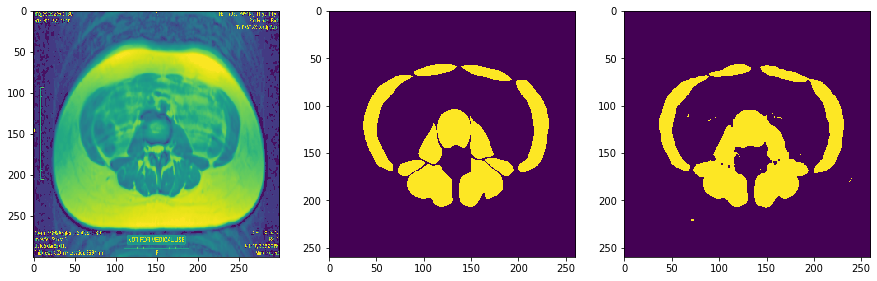

In [41]:
m = neighSize//2
x = res>.1
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
#axes[0].imshow(x)
axes[0].imshow(XYZ[n][0])
axes[1].imshow(XYZ[n][1][m:-m, m:-m])
#axes[3].imshow(XYZ[n][2][m:-m, m:-m])
mkkernel = lambda k: np.ones((k, k))
t = cv2.erode((XYZ[n][2][m:-m, m:-m])*x, mkkernel(2), 1)
axes[2].imshow(t)

In [65]:
import datetime, re
d = re.sub(r':| |\.', '_', f"{datetime.datetime.now()}")
model2.save(f'best_so_far_neighbor_{neighSize}_{d}.model_v04')

In [79]:
ls *v03

best_so_far_neighbor_17_2020-04-13_17_23_17_464782.model_v03
best_so_far_neighbor_41_2020-04-14_14_40_34_896919.model_v03


In [80]:
from keras.models import load_model
model2 = load_model(f'best_so_far_neighbor_41_2020-04-14_14_40_34_896919.model_v03')

In [81]:
tf.test.is_gpu_available()

False

In [82]:
n = np.random.randint(len(XYZ))
print(n)
res = predict_image(XYZ[n][0], model2, neighSize)

55
(300, 300)
260 260 67600 (67600, 1)


In [83]:
res.shape

(260, 260)

In [84]:
XYZ[n][2].shape

(300, 300)

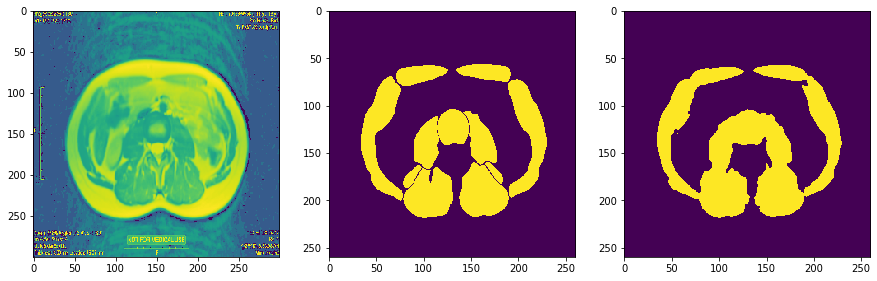

In [85]:
m = neighSize//2
x = res>.1
fig, axes = plt.subplots(1, 3, figsize=(15, 5))
#axes[0].imshow(x)
axes[0].imshow(XYZ[n][0])
axes[1].imshow(XYZ[n][1][m:-m, m:-m])
#axes[3].imshow(nw_XYZ[n][2][m:-m, m:-m])
mkkernel = lambda k: np.ones((k, k))
t = cv2.erode((XYZ[n][2][m:-m, m:-m])*x, mkkernel(2), 1)
axes[2].imshow(t)

In [86]:
#np.random.choice(A, replace=False, size=10)
indices = np.random.choice(range(len(_masked_images)), size=15)
indices

array([136, 183, 392, 209, 278,  75, 482, 458, 441,  86, 226, 379, 269,
       124, 435])

In [87]:
mkdir 'masked'

mkdir: cannot create directory ‘masked’: File exists


In [95]:
for i in indices:
    cv2.imwrite('./masked/masked_%03d.png'%i, (_masked_images[i]-1)*255)

masked_021.png  masked_088.png  masked_144.png  masked_219.png  masked_289.png
masked_030.png  masked_120.png  masked_158.png  masked_239.png  masked_334.png
masked_062.png  masked_140.png  masked_195.png  masked_262.png  masked_436.png


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import cv2
from dask.distributed import Client, LocalCluster
from dask import delayed, compute
from dask import bag, array as da
%load_ext autoreload
%autoreload 2
%pylab inline

/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:458: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:459: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/home/bzr0014/anaconda3/envs/tensorGpu2/lib/python3.6/site-packages/tensorflow/python/framework/dtypes.py:460: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/home/bzr0014/anaconda3/envs/te

Populating the interactive namespace from numpy and matplotlib


In [63]:
# keras important imports:
# import the necessary packages
from keras.models import Sequential
from keras.models import load_model
from keras.layers.normalization import BatchNormalization
from keras.layers.convolutional import Conv2D
from keras.layers.core import Activation
from keras.layers.core import Flatten
from keras.layers.core import Dropout
from keras.layers.core import Dense
from keras import backend as K

from sklearn.preprocessing import LabelBinarizer
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
from keras.preprocessing.image import ImageDataGenerator
from keras.optimizers import Adam
from keras.regularizers import l2

In [647]:
import glob
files = glob.glob('masked/*png')

In [648]:
import re

In [522]:
k = 10
def mardas(x):
    x = cv2.resize(x[:, :, 2], (300, 300), interpolation=cv2.INTER_NEAREST)
    y = cv2.dilate((x).astype('uint8'), np.ones((3,3)))
    indcs =  np.where(y>0)
    t = np.array(indcs).T
    f = np.array([(y>0)[i-k:i+k, j-k:j+k].reshape(-1) for i,j in zip(*indcs)])
    return y, indcs, np.concatenate([f, t], axis=1), y[indcs]

def mardas(args):
    x, y = args
    y = y.mean(axis=2)
    x = cv2.resize(x[:, :, 2], (300, 300), interpolation=cv2.INTER_NEAREST)
    y = cv2.resize(y, (300, 300))
    z = cv2.dilate((x).astype('uint8'), np.ones((3,3)))
    indcs =  np.where(z>0)
    t = np.array(indcs).T
    f = np.array([(z>0)[i-k:i+k, j-k:j+k] for i,j in zip(*indcs)])
    ff = np.array([y[i-k:i+k, j-k:j+k] for i,j in zip(*indcs)])
    f = f.reshape(*f.shape, 1)
    ff = ff.reshape(*ff.shape, 1)
    return z, indcs, (f, ff, t), z[indcs]

In [523]:
X_ = [_raw_images[int(re.findall(r'_(\d{3})\.', x)[0])] for x in files]
Xy = list(map(mardas, zip(map(cv2.imread, files), X_)))

In [524]:
from sklearn.preprocessing import OneHotEncoder, MinMaxScaler
encoder = OneHotEncoder()
scaler = MinMaxScaler()
#X = np.concatenate([x[2] for x in Xy])
#X = scaler.fit_transform(X)
X1 = np.concatenate([x[2][0] for x in Xy])
mu1, sig1 = X1.mean(), X1.std()
X1 = (X1-mu1)/sig1
X2 = np.concatenate([x[2][1] for x in Xy])
mu2, sig2 = X2.mean(), X2.std()
X2 = (X2-mu2)/sig2
X3 = np.concatenate([x[2][2] for x in Xy])
X3 = scaler.fit_transform(X3)
y = np.concatenate([x[3] for x in Xy]).reshape(-1 ,1)
y = encoder.fit_transform(y).toarray()

In [525]:
X1.shape, X2.shape, X3.shape, y.shape

((229227, 20, 20, 1), (229227, 20, 20, 1), (229227, 2), (229227, 11))

In [483]:
from sklearn.model_selection import train_test_split

In [526]:
rnd = np.random.rand(len(X1))
X1tr = X1[rnd>.1]
X1ts = X1[rnd<.1]
X2tr = X2[rnd>.1]
X2ts = X2[rnd<.1]
X3tr = X3[rnd>.1]
X3ts = X3[rnd<.1]
ytr = y[rnd>.1]
yts = y[rnd<.1]

In [528]:
def baseline_model():
	# create model
	model = Sequential()
	model.add(Dense(20, input_dim=(k*2)**2+2, activation='relu'))
	model.add(Dense(11, activation='sigmoid'))
	model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
	return model
model = baseline_model()

import keras
input1 = keras.layers.Input(shape=(2*k,2*k,1))
x1 = keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(input1)
x1 = keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(x1)
x1 = keras.layers.Flatten()(x1)
x1 = keras.layers.Dense(11, activation='relu')(x1)

input2 = keras.layers.Input(shape=(2*k,2*k,1))
x2 = keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(input2)
x2 = keras.layers.Conv2D(8, (3, 3), activation='relu', padding='same')(x2)
x2 = keras.layers.Flatten()(x2)
x2 = keras.layers.Dense(11, activation='relu')(x2)


input3 = keras.layers.Input(shape=(2,))
x3 = keras.layers.Dense(11, activation='relu')(input3)
#x2 = keras.layers.Dense(11, activation='relu')(x2)
# equivalent to added = keras.layers.add([x1, x2])
added = keras.layers.Add()([x1, x2, x3])
added = keras.layers.Dense(11, activation='relu')(added)
out = keras.layers.Dense(11, activation='sigmoid')(added)
model = keras.models.Model(inputs=[input1, input2, input3], outputs=out)
model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])

In [ ]:
model.fit([X1tr, X2tr, X3tr], ytr, batch_size=800, epochs=100, validation_data=([X1ts, X2ts, X3ts], yts))

In [580]:
nn = np.random.randint(len(Xy))
print(nn)
_1, _2, _3 = Xy[nn][:3]

13


In [582]:
_4, _5, _6 = (_3[0]-mu1)/sig1, (_3[1]-mu2)/sig2, scaler.transform(_3[2])
_ = model.predict([_4, _5, _6])
_ = _ / _.sum(axis=1, keepdims=1)
_ = encoder.inverse_transform(_>.1)

In [583]:
imt = np.zeros_like(_1)
#imt[_2] = _.reshape(-1)
imt[_2] = _.reshape(-1)

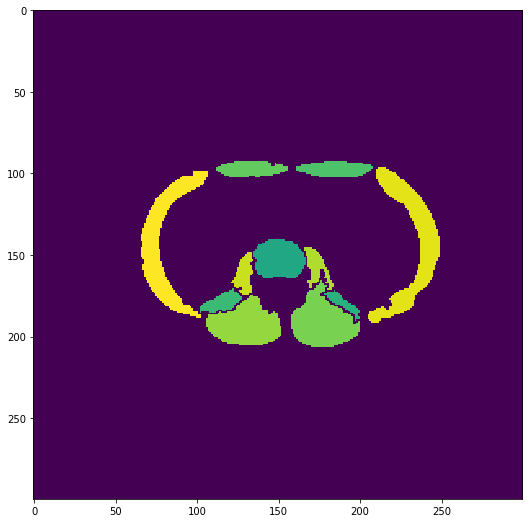

In [584]:
a = np.zeros_like(imt)
for i in np.where(np.bincount(imt.reshape(-1)))[0][1:]:
    tmp = cv2.erode((imt == i).astype('uint8'), np.ones((2, 2)))
    _, cnts, _ = cv2.findContours(tmp.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(cnts, key=lambda x: -len(x))[:1]
    tmp = np.zeros_like(tmp)
    a += cv2.drawContours(tmp, cnts, -1, int(i), -1)
    #a   += cv2.dilate(tmp, np.ones((4, 4)))*i
plt.imshow(a)

In [357]:
def mardas(x):
    imt = np.zeros(tuple(i+2*k for i in x.shape))
    imt[k:-k, k:-k] = x   
    x = imt
    indcs =  np.where(x>0)
    t = np.array(indcs).T
    f = np.array([(x>0)[i-k:i+k, j-k:j+k] for i,j in zip(*indcs)])
    f = f.reshape(*f.shape, 1)
    return x, indcs, [f, t], x[indcs]
def get_classes(x):
    _1, _2, (_31, _32), *_ = mardas(x)
    _4 = model.predict([(_31-mu)/std, scaler.transform(_32)])
    imt = np.zeros_like(x)
    yprd = encoder.inverse_transform(((_4 / _4.sum(axis=1, keepdims=True)) > .1)*1)
    imt[_2] = yprd.reshape(-1)
    return imt
plt.imshow(get_classes(_1))

ValueError: operands could not be broadcast together with shapes (19343,198) (2,) (19343,198) 

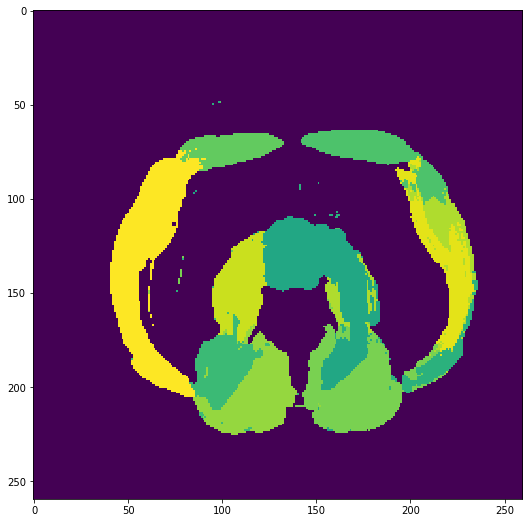

In [288]:
plt.imshow(get_classes((res>.1) & XYZ[55][2][m:-m, m:-m]))

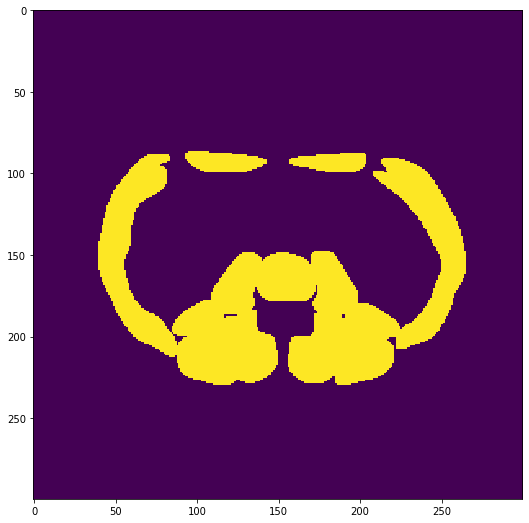

In [237]:
plt.imshow(cv2.dilate((_1>0).astype('uint8'), np.ones((3,3))))

In [204]:
sss.max()

1

In [371]:
N = 10
l = int(np.log(N)/np.log(2))+1

In [376]:
2**(l+4) / N

25.6

In [385]:
t = np.arange(0, 2**(l+4), 25)
["{0:08b}".format(x) for x in t]

['00000000',
 '00011001',
 '00110010',
 '01001011',
 '01100100',
 '01111101',
 '10010110',
 '10101111',
 '11001000',
 '11100001',
 '11111010']

In [409]:
np.abs(t.reshape(1, -1) - np.random.randint(256, size=50).reshape(-1, 1)).argmin(axis=1)

array([ 2,  7,  6,  9,  7,  0,  5,  2,  2,  1,  8,  0,  8,  5,  3,  9,  8,
        7,  7,  8,  3,  2,  8,  9,  6,  4,  9,  5,  6,  0,  6,  9,  1,  1,
        1,  1,  2,  5,  0,  7,  9, 10,  4,  5,  8,  1,  6,  2, 10,  4])

In [411]:
a = np.random.rand(10, 3)

In [425]:
(1+a.dot(a.T**.2))#.sum(axis=0)

array([[2.56706585, 2.33048033, 2.57231358, 2.32754517, 2.39959548,
        2.46850553, 2.60619466, 2.59029428, 2.67219455, 2.50950931],
       [1.8461522 , 1.78965218, 1.81566946, 1.70656476, 1.82201851,
        1.77256526, 1.88060444, 1.90706822, 1.93438748, 1.87899436],
       [2.64719657, 2.34152327, 2.67964964, 2.41197942, 2.43244496,
        2.57600137, 2.67647735, 2.63300826, 2.74030125, 2.52457813],
       [1.71807919, 1.59335194, 1.72852871, 1.62273164, 1.6468314 ,
        1.70085784, 1.73123753, 1.71777445, 1.77027547, 1.66119075],
       [2.12460112, 2.04864037, 2.08534598, 1.9639864 , 2.13420411,
        2.07488206, 2.16669322, 2.20523974, 2.2645669 , 2.13484746],
       [2.30599632, 2.05685682, 2.33585305, 2.14819724, 2.17693592,
        2.30499027, 2.32398922, 2.29043869, 2.40263073, 2.16620148],
       [2.78404888, 2.54116125, 2.7774552 , 2.50184767, 2.60822343,
        2.65326233, 2.83435754, 2.82839538, 2.91010587, 2.74977171],
       [2.80534647, 2.62472982, 2.7682787

In [424]:
(1+a.dot(a[0].T**.2))#.sum()

array([2.56706585, 1.8461522 , 2.64719657, 1.71807919, 2.12460112,
       2.30599632, 2.78404888, 2.80534647, 3.25670011, 2.57840033])

In [585]:
import datetime, re
d = re.sub(r':| |\.', '_', f"{datetime.datetime.now()}")
model.save(f'best_classification_{neighSize}_{d}.model_v03')

In [590]:
#ress = list(map(lambda x: predict_image(x[0], model2, neighSize), XYZ))

(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67

(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67600, 1)
(300, 300)
260 260 67600 (67

In [595]:
XYZT = [(x,y,z,t) for (x,y,z), t in zip(XYZ, ress)]

In [596]:
len(XYZT[0])

4

In [599]:
rs = list(map(lambda x: x[2][m:-m, m:-m] * x[3], XYZT))

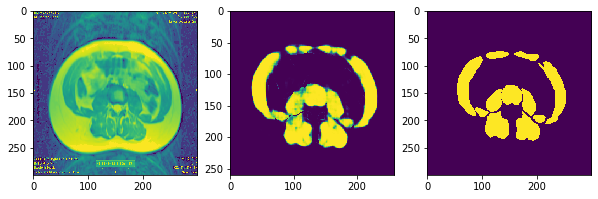

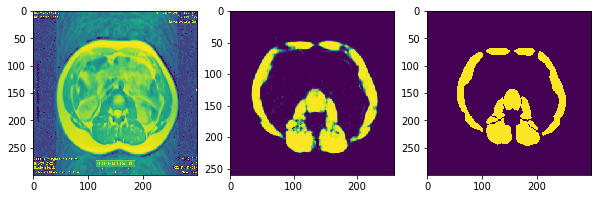

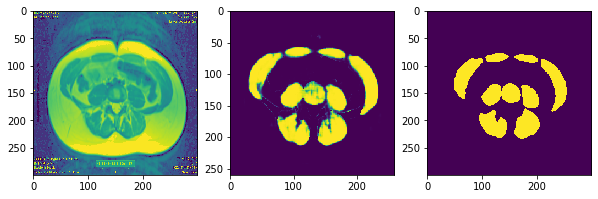

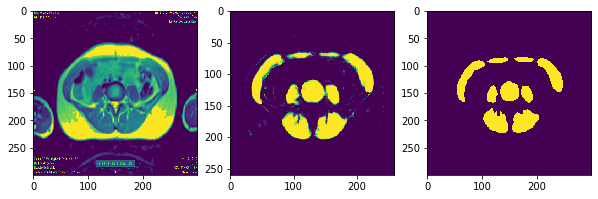

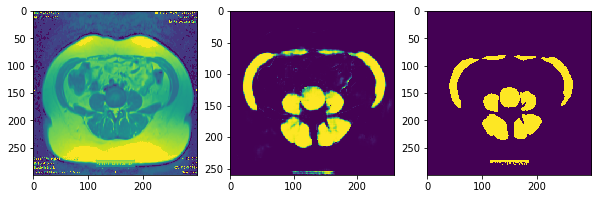

...

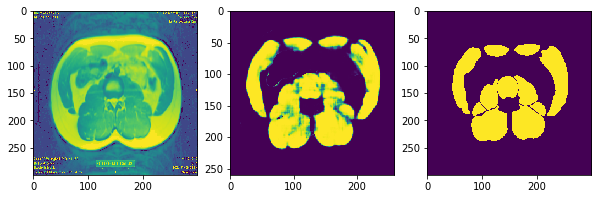

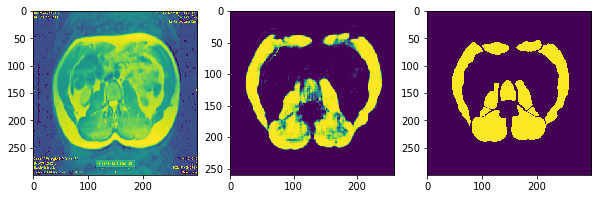

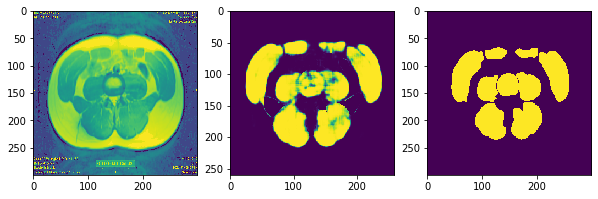

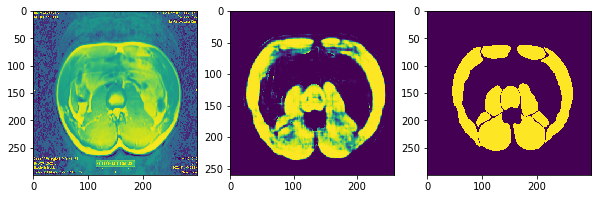

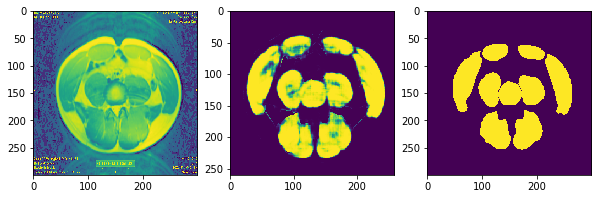

KeyboardInterrupt: 

In [614]:
for x, y, z, t in XYZT:
    fig, axes = plt.subplots(1, 3)
    axes[0].imshow(x)
    axes[1].imshow(z[m:-m, m:-m] * t)
    axes[2].imshow(y)
    plt.show()

In [632]:
def raghas(args):
    x, y = args
    z = cv2.erode((x).astype('uint8'), np.ones((3,3)))
    z = cv2.dilate((z).astype('uint8'), np.ones((3,3)))
    indcs =  np.where(z>0)
    t = np.array(indcs).T
    f = np.array([(z>0)[i-k:i+k, j-k:j+k] for i,j in zip(*indcs)])
    ff = np.array([y[i-k:i+k, j-k:j+k] for i,j in zip(*indcs)])
    f = f.reshape(*f.shape, 1)
    ff = ff.reshape(*ff.shape, 1)
    return z, indcs, (f, ff, t), z[indcs]

In [636]:
_ = XYZT[15]
_1 = ((_[2][m:-m,m:-m] * _[3])>.1).astype('uint8')

In [639]:
_1, _2, _3, *_ = raghas((_1, _[0]))

In [643]:
_4, _5, _6 = (_3[0]-mu1)/sig1, (_3[1]-mu2)/sig2, scaler.transform(_3[2])
_ = model.predict([_4, _5, _6])
_ = _ / _.sum(axis=1, keepdims=1)
_ = encoder.inverse_transform(_>.1)

In [644]:
imt = np.zeros_like(_1)
#imt[_2] = _.reshape(-1)
imt[_2] = _.reshape(-1)

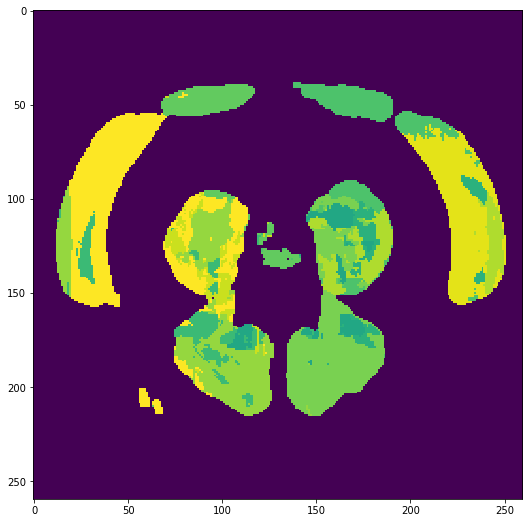

In [646]:
plt.imshow(imt)

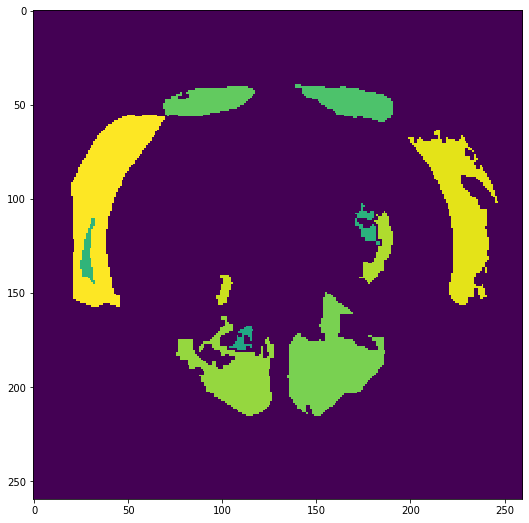

In [645]:
a = np.zeros_like(imt)
for i in np.where(np.bincount(imt.reshape(-1)))[0][1:]:
    tmp = cv2.erode((imt == i).astype('uint8'), np.ones((2, 2)))
    _, cnts, _ = cv2.findContours(tmp.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(cnts, key=lambda x: -len(x))[:1]
    tmp = np.zeros_like(tmp)
    a += cv2.drawContours(tmp, cnts, -1, int(i), -1)
    #a   += cv2.dilate(tmp, np.ones((4, 4)))*i
plt.imshow(a)

In [642]:
_2

(array([ 39,  39,  39, ..., 215, 215, 215]),
 array([138, 139, 140, ..., 150, 151, 152]))

In [640]:
_4, _5, _6 = (_3[0]-mu1)/sig1, (_3[1]-mu2)/sig2, scaler.transform(_3[2])

In [641]:
imt = np.zeros_like(_1)
#imt[_2] = _.reshape(-1)
imt[_2] = _.reshape(-1)

AttributeError: 'list' object has no attribute 'reshape'

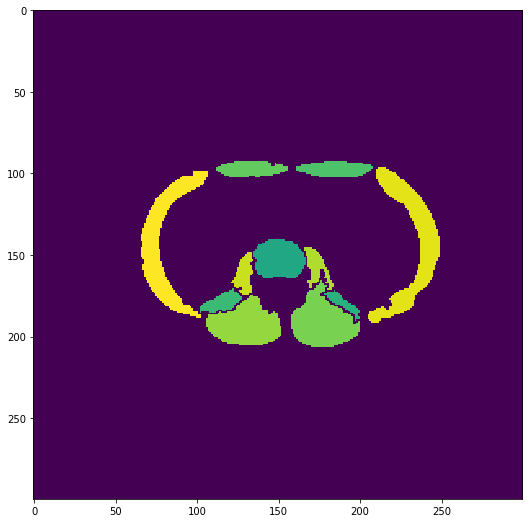

In [584]:
a = np.zeros_like(imt)
for i in np.where(np.bincount(imt.reshape(-1)))[0][1:]:
    tmp = cv2.erode((imt == i).astype('uint8'), np.ones((2, 2)))
    _, cnts, _ = cv2.findContours(tmp.copy(),cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_SIMPLE)
    cnts = sorted(cnts, key=lambda x: -len(x))[:1]
    tmp = np.zeros_like(tmp)
    a += cv2.drawContours(tmp, cnts, -1, int(i), -1)
    #a   += cv2.dilate(tmp, np.ones((4, 4)))*i
plt.imshow(a)